In [1]:
import numpy as np
import pandas as pd
import geopandas as gpd
import requests
import osmnx as ox
import shapely as shp
from ast import literal_eval
from pyproj import Geod
import matplotlib.pyplot as plt
import folium

In [2]:
# somehwere in manhattan
loc = (40.73188892751728, -73.98927188478527)

In [46]:
# osmnx hospital count: 784
osmnx_hospitals = ox.geometries.geometries_from_point(loc, tags={"amenity": ["hospital", "clinic"]}, dist=32000)
osmnx_hospitals

geometry  \
element_type osmid                                                           
node         540400500                          POINT (-74.26669 40.67634)   
             1002534852                         POINT (-74.07083 40.71097)   
             2015849773                         POINT (-73.99342 40.68718)   
             2543331005                         POINT (-74.16253 40.59414)   
             2550589973                         POINT (-73.98930 40.66584)   
...                                                                    ...   
way          721524163   POLYGON ((-73.94347 40.65575, -73.94342 40.655...   
             753599730   POLYGON ((-73.97939 40.61643, -73.97916 40.616...   
             845192544   POLYGON ((-73.86782 40.65689, -73.86611 40.657...   
             1060381335  POLYGON ((-73.68522 40.67922, -73.68527 40.679...   
relation     3364740     POLYGON ((-73.91736 40.70463, -73.91739 40.704...   

                             addr:city addr:housenumber addr:postcode  \
element_type osmid                                                      
node         540400500           Union             1000         07083   
             1002534852            NaN              NaN           NaN   
             2015849773            NaN              203         11201   
             2543331005            NaN             2187         10314   
             2550589973            NaN              550         11215   
...                                ...              ...           ...   
way          721524163        Brooklyn              445         11203   
             753599730             NaN             6010         11204   
             845192544             NaN              NaN           NaN   
             1060381335  Valley Stream             1072         11580   
relation     3364740          Brooklyn              374         11237   

                                 addr:street   amenity beds emergency  \
element_type osmid                                                      
node         540400500   Galloping Hill Road    clinic   24       yes   
             1002534852                  NaN    clinic  NaN       NaN   
             2015849773         Court Street    clinic  NaN       NaN   
             2543331005      Richmond Avenue    clinic  NaN       NaN   
             2550589973           5th Avenue    clinic  NaN       NaN   
...                                      ...       ...  ...       ...   
way          721524163            Lenox Road  hospital  342       yes   
             753599730           Bay Parkway    clinic  NaN       NaN   
             845192544                   NaN  hospital  NaN       NaN   
             1060381335      Franklin Avenue    clinic  NaN       NaN   
relation     3364740        Stockholm Street  hospital  350       yes   

                                                                      name  \
element_type osmid                                                           
node         540400500          Overlook Emergency Services – Union Campus   
             1002534852                               Family Health Clinic   
             2015849773                                           Carecube   
             2543331005                                             CityMD   
             2550589973                                 Maimonides Doctors   
...                                                                    ...   
way          721524163                     University Hospital of Brooklyn   
             753599730                           Maimonides Medical Center   
             845192544   Brooklyn Developmental Disabilities Services O...   
             1060381335                              North Shore LIJ Annex   
relation     3364740                        Wyckoff Heights Medical Center   

                                   note  ... check_date:opening_hours  \
element_type osmid                       ...                   

In [45]:
m = folium.Map(list(loc), zoom_start=16)

In [47]:
folium.GeoJson(data=osmnx_hospitals['geometry']).add_to(m)

In [48]:
m

In [6]:
# using the healthcare facility general information from the ny data website
ny_hospitals = pd.read_csv("data/Health_Facility_General_Information.csv")
ny_hospitals.columns

Index(['Facility ID', 'Facility Name', 'Short Description', 'Description',
       'Facility Open Date', 'Facility Address 1', 'Facility Address 2',
       'Facility City', 'Facility State', 'Facility Zip Code',
       'Facility Phone Number', 'Facility Fax Number', 'Facility Website',
       'Facility County Code', 'Facility County', 'Regional Office ID',
       'Regional Office', 'Main Site Name', 'Main Site Facility ID',
       'Operating Certificate Number', 'Operator Name', 'Operator Address 1',
       'Operator Address 2', 'Operator City', 'Operator State',
       'Operator Zip Code', 'Cooperator Name', 'Cooperator Address',
       'Cooperator Address 2', 'Cooperator City', 'Cooperator State',
       'Cooperator Zip Code', 'Ownership Type', 'Facility Latitude',
       'Facility Longitude', 'Facility Location'],
      dtype='object')

In [7]:
# list of general types of hospitals in this dataset
ny_hospitals["Description"].value_counts()

Licensed Home Care Services Agency                                       1433
Hospital Extension Clinic                                                1212
Diagnostic and Treatment Center Extension Clinic                          798
Residential Health Care Facility - SNF                                    621
Diagnostic and Treatment Center                                           579
                                                                         ... 
Primary Care Hospital - Critical Access Hospital Extension Clinic          40
Adult Day Health Care Program - Offsite                                    38
Mobile Hospital Extension Clinic                                           21
Primary Care Hospital - Critical Access Hospital                           20
School Based Primary Care Hospital - Critical Access Extension Clinic       5
Name: Description, Length: 19, dtype: int64

In [8]:
ny_hospitals.iloc[0][["Facility Address 1", "Facility State", "Facility Zip Code"]]

Facility Address 1    220 Tower Street
Facility State                New York
Facility Zip Code                13480
Name: 0, dtype: object

In [9]:
# convert a latlon to a shapely point
def convert_to_point(row):
    if np.isnan(row["Facility Latitude"]):
        return shp.Point((0, 0))
    else:
        return shp.Point((float(row["Facility Longitude"]), float(row["Facility Latitude"])))

In [10]:
ny_hospitals["geometry"] = ny_hospitals.apply(lambda x: convert_to_point(x), axis=1)

In [11]:
# 371 hospitals missing geometry, not shown on this plot
(ny_hospitals["geometry"] == shp.Point((0, 0))).sum()

371

In [12]:
# has hospitals from all over the state
ny_hospitals_gdf = gpd.GeoDataFrame(ny_hospitals, geometry="geometry", crs="EPSG:4326")
ny_hospitals_gdf.explore()

In [8]:
# filter out only nyc hospoitals
geod = Geod(ellps="WGS84")

In [14]:
ny_hospitals_gdf["dist_from_nyc"] = ny_hospitals_gdf["geometry"].apply(lambda x: geod.geometry_length(shp.geometry.LineString([x, shp.Point((loc[1], loc[0]))])))
ny_hospitals_gdf["dist_from_nyc"].describe()

count    6.132000e+03
mean     6.712690e+05
std      2.035252e+06
min      3.503383e+02
25%      1.621973e+04
50%      8.244176e+04
75%      3.344734e+05
max      8.666418e+06
Name: dist_from_nyc, dtype: float64

In [15]:
# extract hospitals less than 32 km away from point in manhattan
nyc_hospitals_gdf = ny_hospitals_gdf[ny_hospitals_gdf["dist_from_nyc"] <= 32000]
nyc_hospitals_gdf

,Facility ID,Facility Name,Short Description,Description,Facility Open Date,Facility Address 1,Facility Address 2,Facility City,Facility State,Facility Zip Code,...,Cooperator Address 2,Cooperator City,Cooperator State,Cooperator Zip Code,Ownership Type,Facility Latitude,Facility Longitude,Facility Location,geometry,dist_from_nyc
2,1370,The Riverside,NH,Residential Health Care Facility - SNF,09/28/1981,150 Riverside Drive,NaN,New York,New York,10024,...,NaN,NaN,New York,NaN,LLC,40.790638,-73.979767,"(40.790638, -73.979767)",POINT (-73.97977 40.79064),6573.223217
7,6035,Barnabas Hospital Methadone,HOSP-EC,Hospital Extension Clinic,07/18/1996,4535-39 Third Avenue,NaN,Bronx,New York,10457,...,NaN,NaN,New York,NaN,Not for Profit Corporation,40.854229,-73.890892,"(40.854229, -73.890892)",POINT (-73.89089 40.85423),15922.181955
15,7769,Sheepshead Bay Surgery Center,DTC,Diagnostic and Treatment Center,06/17/1999,2269 Ocean Avenue,NaN,Brooklyn,New York,11229,...,NaN,NaN,New York,NaN,Business Corporation,40.606426,-73.952667,"(40.606426, -73.952667)",POINT (-73.95267 40.60643),14271.999184
17,9013,Mobile Medical Unit,NaN,Mobile Hospital Extension Clinic,02/20/2009,460 Brielle Avenue,NaN,Staten Island,New York,10314,...,NaN,NaN,New York,NaN,Municipality,40.593884,-74.135338,"(40.593884, -74.135338)",POINT (-74.13534 40.59388),19683.052686
23,9970,"Parkmed NYC, LLC",DTC,Diagnostic and Treatment Center,10/31/2016,"800 Second Avenue, 6th Floor",NaN,New York,New York,10017,...,NaN,NaN,New York,NaN,LLC,40.750033,-73.971612,"(40.750033, -73.971612)",POINT (-73.97161 40.75003),2506.923922
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6110,1369,New York Congregational Nursing Center,NH,Residential Health Care Facility - SNF,01/01/1901,135 Linden Boulevard,NaN,Brooklyn,New York,11226,...,NaN,NaN,New York,NaN,LLC,40.652481,-73.953758,"(40.652481, -73.953758)",POINT (-73.95376 40.65248),9315.021923
6118,13109,"Hand In Hand Homecare, Llc",LHCSA,Licensed Home Care Services Agency,06/23/2015,4200 White Plains Road,Suite 101,Bronx,New York,10466,...,NaN,NaN,New York,NaN,LLC,40.893549,-73.856988,"(40.893549, -73.856988)",POINT (-73.85699 40.89355),21139.065049
6119,6844,Planned Parenthood Project Street Beat Mobile ...,NaN,Mobile Diagnostic and Treatment Center Extensi...,01/13/2006,26 Bleecker Street,NaN,New York,New York,10012,...,NaN,NaN,New York,NaN,Not for Profit Corporation,40.725521,-73.993538,"(40.725521, -73.993538)",POINT (-73.99354 40.72552),793.692451
6121,12832,Home Instead,LHCSA,Licensed Home Care Services Agency,07/28/2005,400 E 56th St,Professional Wing Ste 2,New York,New York,10022,...,NaN,NaN,New York,NaN,Business Corporation,40.757538,-73.963374,"(40.757538, -73.963374)",POINT (-73.96337 40.75754),3591.260274


In [72]:
# decent amount of entries, although not all are very relevant
nyc_hospitals_gdf["Description"].value_counts()

Licensed Home Care Services Agency                               696
Diagnostic and Treatment Center Extension Clinic                 377
Hospital Extension Clinic                                        300
Diagnostic and Treatment Center                                  247
Residential Health Care Facility - SNF                           203
School Based Hospital Extension Clinic                           122
School Based Diagnostic and Treatment Center Extension Clinic     96
Hospital                                                          80
Adult Home                                                        68
Enriched Housing Program                                          41
Certified Home Health Agency                                      39
Mobile Diagnostic and Treatment Center Extension Clinic           22
Adult Day Health Care Program - Offsite                           16
Long Term Home Health Care Program                                13
Hospice                           

In [73]:
gpd.GeoDataFrame(nyc_hospitals_gdf, crs="EPSG:4326").explore(color="red")

In [51]:
# reading in the data sourced from arcgis detailing urgent care facilities
arcgis_urgentcare = gpd.read_file("data/UrgentCareFacilities.gdb/")
arcgis_urgentcare.head()

,ID,NAME,ADDRESS,ADDRESS2,CITY,STATE,ZIP,COUNTY,FIPS,DIRECTIONS,NAICSCODE,NAICSDESCR,GEOPREC,PHONELOC,PHONE,ZIP4,LONGITUDE,LATITUDE,geometry
0,10193191,FAIRBANKS URGENT CARE CENTER,1867 AIRPORT WAY,SUITE 130B,FAIRBANKS,AK,99701,FAIRBANKS NORTH STAR,02090,LOCATED ON THE SOUTH SIDE OF AIRPORT WAY (SOUT...,621493,URGENT MEDICAL CARE CENTERS AND CLINICS (EXCEP...,ONENTITY,YES,(907) 452-2178,4056,-147.756405,64.835818,POINT (-147.75640 64.83582)
1,10421243,1ST CARE,1101 NOBLE STREET,NOT AVAILABLE,FAIRBANKS,AK,99701,FAIRBANKS NORTH STAR,02090,LOCATED ON THE EAST SIDE OF NOBLE STREET BETWE...,621493,URGENT MEDICAL CARE CENTERS AND CLINICS (EXCEP...,ONENTITY,YES,(907) 458-2682,4924,-147.713357,64.838565,POINT (-147.71336 64.83857)
2,10844602,ROCKWOOD - CHENEY MEDICAL CENTER,19 NORTH 7TH STREET,NOT AVAILABLE,CHENEY,WA,99004,SPOKANE,53063,LOCATED ON THE NE CORNER OF NORTH 7TH STREET A...,621493,URGENT MEDICAL CARE CENTERS AND CLINICS (EXCEP...,ONENTITY,YES,(509) 235-6151,2220,-117.577696,47.493125,POINT (-117.57770 47.49313)
3,10844607,ROCKWOOD - NORTH CLINIC,9001 NORTH COUNTRY HOMES BOULEVARD,NOT AVAILABLE,SPOKANE,WA,99218,SPOKANE,53063,LOCATED ON THE NE CORNER OF NORTH COUNTRY HOME...,621493,URGENT MEDICAL CARE CENTERS AND CLINICS (EXCEP...,ONENTITY,YES,(509) 744-1700,2072,-117.415760,47.739681,POINT (-117.41576 47.73968)
4,10425848,VANCOUVER CLINIC - SALMON CREEK SAME DAY SERVICES,2525 NE 139TH STREET,NOT AVAILABLE,VANCOUVER,WA,98686,CLARK,53011,LOCATED AT THE SE CORNER OF NE 139TH STREET AN...,621493,URGENT MEDICAL CARE CENTERS AND CLINICS (EXCEP...,ONENTITY,YES,(360) 397-3970,2719,-122.644800,45.720730,POINT (-122.64480 45.72073)


In [18]:
arcgis_urgentcare.explore()

In [19]:
arcgis_urgentcare["dist_from_nyc"] = arcgis_urgentcare["geometry"].apply(lambda x: geod.geometry_length(shp.geometry.LineString([x, shp.Point(loc[::-1])])))
arcgis_urgentcare["dist_from_nyc"].describe()

count    4.810000e+03
mean     1.876474e+06
std      1.299106e+06
min      1.848483e+03
25%      8.806649e+05
50%      1.550283e+06
75%      2.748149e+06
max      8.012373e+06
Name: dist_from_nyc, dtype: float64

In [20]:
# only 53 entries within 32km from manhattan
arcgis_urgentcare_nyc = arcgis_urgentcare_nyc = arcgis_urgentcare[(arcgis_urgentcare["dist_from_nyc"] <= 32000) & (arcgis_urgentcare["STATE"] == "NY")]
arcgis_urgentcare_nyc 

,ID,NAME,ADDRESS,ADDRESS2,CITY,STATE,ZIP,COUNTY,FIPS,DIRECTIONS,NAICSCODE,NAICSDESCR,GEOPREC,PHONELOC,PHONE,ZIP4,LONGITUDE,LATITUDE,geometry,dist_from_nyc
3002,10194027,STAT MD PROFESSIONAL LIMITED LIABILITIES COMPANY,2029 JERICHO TURNPIKE,NOT AVAILABLE,NEW HYDE PARK,NY,11040,NASSAU,36059,NORTH OF JERICHO TURNPIKE BETWEEN LEONARD BOUL...,621493,URGENT MEDICAL CARE CENTERS AND CLINICS (EXCEP...,ONENTITY,YES,(516) 352-7828,4720,-73.673968,40.735974,POINT (-73.67397 40.73597),26638.440781
3011,11513047,NORTHERN URGENT CARE CENTER,164-18 NORTHERN BOULEVARD,NOT AVAILABLE,FLUSHING,NY,11358,QUEENS,36081,LOCATED ON THE SW SIDE OF NORTHERN BOULEVARD B...,621493,URGENT MEDICAL CARE CENTERS AND CLINICS (EXCEP...,ONENTITY,YES,(718) 939-5900,2647,-73.801776,40.760248,POINT (-73.80178 40.76025),16145.505465
3012,11513029,RAPID MEDICAL CENTER,3316 BROADWAY,NOT AVAILABLE,LONG ISLAND CITY,NY,11106,QUEENS,36081,LOCATED ON THE SW SIDE OF BROADWAY BETWEEN 33R...,621493,URGENT MEDICAL CARE CENTERS AND CLINICS (EXCEP...,ONENTITY,YES,(718) 626-6010,1806,-73.923338,40.760830,POINT (-73.92334 40.76083),6429.460912
3051,10470823,NASSAU IMMEDIATE MEDICAL CARE,465 WILLIS AVENUE,NOT AVAILABLE,WILLISTON PARK,NY,11596,NASSAU,36059,WEST OF WILLIS AVENUE BETWEEN HILLSIDE AVENUE ...,621493,URGENT MEDICAL CARE CENTERS AND CLINICS (EXCEP...,ONENTITY,YES,(516) 294-3535,1724,-73.645556,40.756488,POINT (-73.64556 40.75649),29158.356797
3148,10844026,QUICK DOCS,255 EAST 98TH STREET,NOT AVAILABLE,BROOKLYN,NY,11212,KINGS,36047,NE CORNER OF EAST 98TH STREET AND HOWARD AVENUE,621493,URGENT MEDICAL CARE CENTERS AND CLINICS (EXCEP...,ONENTITY,YES,(718) 240-2673,8817,-73.918658,40.661457,POINT (-73.91866 40.66146),9838.348409
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4654,10844014,CONCENTRA URGENT CARE - ELIZABETH,595 DIVISION STREET,NOT AVAILABLE,ELIZABETH,NJ,07201,UNION,34039,LOCATED ON THE EAST SIDE OF DIVISION STREET BE...,621493,URGENT MEDICAL CARE CENTERS AND CLINICS (EXCEP...,ONENTITY,YES,(908) 289-5646,2038,-74.193076,40.670703,POINT (-74.19308 40.67070),18516.030584
4731,10193985,DOCTORS MEDICENTER,835 ROOSEVELT AVENUE,NOT AVAILABLE,CARTERET,NJ,07008,MIDDLESEX,34023,LOCATED ON THE SW SIDE OF ROOSEVELT AVENUE BET...,621493,URGENT MEDICAL CARE CENTERS AND CLINICS (EXCEP...,ONENTITY,YES,(732) 969-2240,1815,-74.230108,40.590333,POINT (-74.23011 40.59033),25727.039495
4748,10197427,CARE STATION I - LINDEN,328 WEST SAINT GEORGES AVENUE,NOT AVAILABLE,LINDEN,NJ,07036,UNION,34039,WEST SIDE OF WEST SAINT GEORGES AVENUE BETWEEN...,621493,URGENT MEDICAL CARE CENTERS AND CLINICS (EXCEP...,ONENTITY,YES,(908) 925-2273,5638,-74.268497,40.633431,POINT (-74.26850 40.63377),25998.241213
4760,10197426,CARE STATION II - SPRINGFIELD,90 UNITED STATES HIGHWAY 22 WEST,NOT AVAILABLE,SPRINGFIELD,NJ,07081,UNION,34039,NORTH SIDE OF US-22 BETWEEN STERN AVENUE AND B...,621493,URGENT MEDICAL CARE CENTERS AND CLINICS (EXCEP...,ONENTITY,YES,(973) 467-2273,N/A,-74.315856,40.688097,POINT (-74.31586 40.68810),28022.469068


In [57]:
arcgis_urgentcare_nyc.explore(color="red")

In [49]:
arcgis_hospitals = pd.read_csv("data/Hospitals.csv")
arcgis_hospitals

,X,Y,OBJECTID,ID,NAME,ADDRESS,CITY,STATE,ZIP,ZIP4,...,VAL_DATE,WEBSITE,STATE_ID,ALT_NAME,ST_FIPS,OWNER,TTL_STAFF,BEDS,TRAUMA,HELIPAD
0,-86.494549,31.295795,1,1336420,ANDALUSIA HEALTH,"849 SOUTH THREE NOTCH STREET, PO BOX 760",ANDALUSIA,AL,36420,NOT AVAILABLE,...,2014/02/10 00:00:00+00,http://www.andalusiaregionalhospital.com,H2001,NOT AVAILABLE,1,PROPRIETARY,-999,88,LEVEL III,Y
1,-86.978407,34.804164,2,1535611,ATHENS LIMESTONE HOSPITAL,700 WEST MARKET STREET,ATHENS,AL,35611,NOT AVAILABLE,...,2013/10/02 00:00:00+00,http://www.athenslimestonehospital.com,H4201,NOT AVAILABLE,1,PROPRIETARY,-999,71,LEVEL III,N
2,-87.478799,31.017024,3,136502,ATMORE COMMUNITY HOSPITAL,401 MEDICAL PARK DR,ATMORE,AL,36502,NOT AVAILABLE,...,2014/02/10 00:00:00+00,http://www.ebaptisthealthcare.org/atmorecommun...,H2704,NOT AVAILABLE,1,NON-PROFIT,-999,51,LEVEL III,Y
3,-86.174930,32.376399,4,236124,BAPTIST MEDICAL CENTER EAST,"400 TAYLOR ROAD, PO BOX 241267",MONTGOMERY,AL,36117,1267,...,2013/09/03 00:00:00+00,http://www.baptistfirst.org,H5107,NOT AVAILABLE,1,GOVERNMENT - DISTRICT/AUTHORITY,-999,150,NOT AVAILABLE,Y
4,-86.277549,32.328154,5,1736111,BAPTIST MEDICAL CENTER SOUTH,"2105 EAST SOUTH BOULEVARD, PO BOX 11010",MONTGOMERY,AL,36111,0010,...,2014/03/12 00:00:00+00,http://www.baptistfirst.org,H5102,NOT AVAILABLE,1,GOVERNMENT - DISTRICT/AUTHORITY,-999,432,LEVEL II,Y
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8008,-74.347278,40.500067,8117,196784290,UNIVERSITY HOSPITAL,97 SUNFIELD AVENUE,EDISON,NJ,8837,NOT AVAILABLE,...,2022/04/07 00:00:00+00,NOT AVAILABLE,NOT AVAILABLE,NOT AVAILABLE,34,NOT AVAILABLE,-999,-999,NOT AVAILABLE,NOT AVAILABLE
8009,-104.754827,38.968781,8118,196784298,CHILDREN'S HOSPITAL OF COLORADO - COLORADO SPR...,4090 BRIARGATE PARKWAY,COLORADO SPRINGS,CO,80920,NOT AVAILABLE,...,2022/04/07 00:00:00+00,NOT AVAILABLE,NOT AVAILABLE,NOT AVAILABLE,8,NOT AVAILABLE,-999,-999,NOT AVAILABLE,Y
8010,-91.219417,30.266626,8119,196784302,OCHSNER MEDICAL COMPLEX IBERVILLE,25455 LA-1,PLAQUEMINE,LA,70764,NOT AVAILABLE,...,2022/04/07 00:00:00+00,NOT AVAILABLE,NOT AVAILABLE,NOT AVAILABLE,22,NOT AVAILABLE,-999,-999,NOT AVAILABLE,Y
8011,-83.811348,39.939755,8120,196784919,MERCY HEALTH FOUNTIAN MEDICAL CAMPUS,100 W MCCREIGHT AVE,SPRINGFIELD,OH,45504,NOT AVAILABLE,...,2022/05/02 00:00:00+00,https://www.mercy.com/,NOT AVAILABLE,NOT AVAILABLE,39,PROPRIETARY,-999,-999,NOT AVAILABLE,N


In [55]:
arcgis_hospitals["geometry"] = arcgis_hospitals.apply(lambda x: shp.Point((x["LONGITUDE"], x["LATITUDE"])), axis=1)

In [56]:
gpd.GeoDataFrame(arcgis_hospitals, crs="EPSG:4326").explore(color="red")

In [38]:
arcgis_hospitals["dist_from_ny"] = arcgis_hospitals["geometry"].apply(lambda x: geod.geometry_length(shp.geometry.LineString([x, shp.Point((loc[1], loc[0]))])))
arcgis_hospitals["dist_from_ny"].describe()

count    8.013000e+03
mean     1.823892e+06
std      1.260117e+06
min      4.045355e+02
25%      9.192583e+05
50%      1.650428e+06
75%      2.445626e+06
max      1.394114e+07
Name: dist_from_ny, dtype: float64

In [40]:
arcgis_hospitals_nyc = arcgis_hospitals[(arcgis_hospitals["dist_from_ny"] <= 32000) & (arcgis_hospitals["STATE"] == "NY")]
arcgis_hospitals_nyc

,X,Y,OBJECTID,ID,NAME,ADDRESS,CITY,STATE,ZIP,ZIP4,...,STATE_ID,ALT_NAME,ST_FIPS,OWNER,TTL_STAFF,BEDS,TRAUMA,HELIPAD,geometry,dist_from_ny
3964,-74.062992,40.956668,4055,12207652,BERGEN NEW BRIDGE MEDICAL CENTER,230 EAST RIDGEWOOD AVE,PARAMUS,NJ,7652,NOT AVAILABLE,...,NJ310058,BERGEN COUNTY IMPROVEMENT AUTHORITY,34,GOVERNMENT - LOCAL,-999,496,NOT AVAILABLE,N,POINT (-74.06299 40.95667),25724.446496
3968,-74.015021,40.985529,4059,109107675,CARE ONE AT HUMC PASCACK VALLEY,"250 OLD HOOK ROAD, 4TH FLOOR",WESTWOOD,NJ,7675,NOT AVAILABLE,...,NJ24795,THE REHABILITATION HOSPITAL AT RARITAN BAY MC,34,PROPRIETARY,-999,25,NOT AVAILABLE,Y,POINT (-74.01502 40.98553),28250.618828
3971,-74.214918,40.658620,4062,109207207,CARE ONE AT TRINITAS REGIONAL MEDICAL CENTER,"225 WILLIAMSON ST, 7 NORTH",ELIZABETH,NJ,7207,NOT AVAILABLE,...,NJ23098,THE REHABILITATION HOSPITAL AT RARITAN BAY MED...,34,PROPRIETARY,-999,25,NOT AVAILABLE,N,POINT (-74.21492 40.65862),20734.978765
3972,-74.112714,40.668304,4063,107907002,CAREPOINT HEALTH - BAYONNE MEDICAL CENTER,29 EAST 29TH ST,BAYONNE,NJ,7002,NOT AVAILABLE,...,NJ10901,"IJKG OPCO, L.L.C.",34,PROPRIETARY,-999,244,NOT AVAILABLE,N,POINT (-74.11271 40.66830),12597.630527
3973,-74.049958,40.734268,4064,108007306,CAREPOINT HEALTH - CHRIST HOSPITAL,176 PALISADE AVE,JERSEY CITY,NJ,7306,NOT AVAILABLE,...,NJ10902,"HUDSON HOSPITAL OPCO, LLC",34,PROPRIETARY,-999,349,NOT AVAILABLE,N,POINT (-74.04996 40.73427),5133.203615
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7702,-74.128775,40.850992,7806,6807055,SAINT MARYS HOSPITAL - PASSAIC,211 PENNINGTON AVENUE,PASSAIC,NJ,7055,NOT AVAILABLE,...,11606,NOT AVAILABLE,34,NON-PROFIT,-999,269,NOT AVAILABLE,N,POINT (-74.12878 40.85099),17707.812357
7818,-73.942144,40.770302,7924,19010044,COLER-GOLDWATER SPECIALTY HOSPITAL AND NURSING...,900 MAIN STREET ROOSEVELT ISLAND,NEW YORK,NY,10044,NOT AVAILABLE,...,7002051H,NOT AVAILABLE,36,GOVERNMENT - LOCAL,-999,210,NOT AVAILABLE,N,POINT (-73.94214 40.77030),5834.129008
7871,-74.211928,40.709470,7978,1207112,CHILDRENS HOSPITAL OF NEW JERSEY - NEWARK,201 LYONS AVENUE,NEWARK,NJ,7112,NOT AVAILABLE,...,NOT AVAILABLE,NOT AVAILABLE,34,NON-PROFIT,-999,-999,NOT AVAILABLE,N,POINT (-74.21193 40.70947),18976.055326
7967,-74.204853,40.946686,8076,507470,KINDRED HOSPITAL NJ-WAYNE,224 HAMBURG TURNPIKE,WAYNE,NJ,7470,NOT AVAILABLE,...,NJ24048,NOT AVAILABLE,34,PROPRIETARY,-999,38,NOT AVAILABLE,N,POINT (-74.20485 40.94669),29992.794091


In [53]:
gpd.GeoDataFrame(arcgis_hospitals_nyc, crs="EPSG:4326").explore(color="red")

In [59]:
# read in nyc health patient care location data
nyc_health_df = pd.read_csv("data/NYC_Health___Hospitals_patient_care_locations_-_2011.csv")
nyc_health_df

,Facility Type,Borough,Facility Name,Cross Streets,Phone,Location 1,Postcode,Latitude,Longitude,Community Board,Council District,Census Tract,BIN,BBL,NTA
0,Child Health Center,Manhattan,La Clinica Del Barrio,NaN,212-410-7940,"413 120th Street\nNew York, NY 10035\n(40.7982...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,Acute Care Hospital,Queens,Elmhurst Hospital Center,NaN,718-334-4000,"79 01\nElmhurst, NY 11373\n(40.738710402563, -...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,Child Health Center,Brooklyn,Ida G. Israel Community Health Center,W. 22nd St. & W. 23rd St.,718-946-3400,"2201 Neptune Avenue\nBrooklyn, NY 11224\n(40.5...",11224.0,40.578468,-73.989614,13.0,47.0,348.0,3188417.0,3.069900e+09,Seagate-Coney Island ...
3,Child Health Center,Queens,South Queens Community Health Center,NaN,718-883-6699,"114 02 Guy R Brewer Blvd\nJamaica, NY 11434\n(...",11434.0,40.688615,-73.785593,12.0,28.0,276.0,4264631.0,4.122000e+09,Baisley Park ...
4,Child Health Center,Bronx,Melrose Houses Child Health Clinic,between Morris Ave. & Courtlandt Ave.,718-292-2820,"348 156th Street\nBronx, NY 10451\n(40.8213011...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
73,Child Health Center,Brooklyn,Bushwick Community Health Center,NaN,718-919-1200,"1420 Bushwick Avenue\nBrooklyn, NY 11207\n(40....",11207.0,40.684318,-73.909056,4.0,37.0,403.0,3080067.0,3.034440e+09,Bushwick South ...
74,Child Health Center,Manhattan,Bellevue Hospital Center,NaN,212-562-4141,"462 First Avenue\nNew York, NY 10016\n(40.7396...",10016.0,40.739173,-73.976862,6.0,4.0,62.0,1086515.0,1.009620e+09,Murray Hill-Kips Bay ...
75,Child Health Center,Queens,Ridgewood Communicare Clinic,between Woodbine St. & Madison St.,718-334-6190,"769 Onderdonk Avenue\nRidgewood, NY 11385\n(40...",11385.0,40.702972,-73.905489,5.0,34.0,549.0,4083018.0,4.034700e+09,Ridgewood ...
76,Child Health Center,Manhattan,Smith Communicare Health Center,corner of Catherine St.,212-346-0500,"60 Madison Street\nNew York, NY 10038\n(40.711...",10038.0,40.712019,-73.997309,3.0,1.0,25.0,1077421.0,1.001110e+09,Chinatown ...


In [61]:
nyc_health_df["Latitude"] = nyc_health_df["Latitude"].fillna(0)
nyc_health_df["Longitude"] = nyc_health_df["Longitude"].fillna(0)

In [69]:
nyc_health_df["geometry"] = nyc_health_df.apply(lambda x: shp.Point((x["Longitude"], x["Latitude"])), axis=1)

In [70]:
gpd.GeoDataFrame(nyc_health_df, crs="EPSG:4326").explore(color="red")

In [20]:
# seems to only have a subset of everything found in the general heatlh facility dataset
nyc_health_df["Facility Type"].value_counts()

Child Health Center              56
Acute Care Hospital              11
Diagnostic & Treatment Center     6
Nursing Home                      5
Name: Facility Type, dtype: int64

In [3]:
# read in medicaid institution dataset (sourced from medicaid); details institutions around the US that are registered with medicaid
medicaid_institutions = pd.read_csv("data/Institutional_Provider_Network_Data__2018_Quarter_4.csv")
medicaid_institutions 

C:\Users\yianz\AppData\Local\Temp\ipykernel_21476\288729600.py:2: DtypeWarning: Columns (1,12,13,14) have mixed types. Specify dtype option on import or set low_memory=False.
  medicaid_institutions = pd.read_csv("data/Institutional_Provider_Network_Data__2018_Quarter_4.csv")


,SiteName_std,roomno,Address1_std,City_std,TrueCountyFIPS,TrueCountyName,State_std,Zip_std,Latitude,Longitude,...,hx_shp_med_ind_9,hx_shp_med_ind_10,ServCnty1,ServCnty2,ServCnty3,ServCnty4,ServCnty5,PlanName,PNDSID,Quarter
0,A+ MEDITRANS,NaN,23 RAILROAD AVE,ALBANY,36001.0,Albany,NY,12205.0,42.721239,-73.855800,...,0,0,999,999,999,999,999,Eddy Senior Care,28,Quarter4 2018
1,ACCENT HEALTH CARE SERVICES INC,NaN,820 5TH AVE,TROY,36083.0,Rensselaer,NY,12182.0,42.783162,-73.669198,...,0,0,83,93,999,999,999,Eddy Senior Care,28,Quarter4 2018
2,ALBANY COUNTY NURSING HOME,NaN,780 ALBANY SHAKER RD,ALBANY,36001.0,Albany,NY,12211.0,42.744227,-73.813865,...,0,0,999,999,999,999,999,Eddy Senior Care,28,Quarter4 2018
3,ALBANY REGIONAL EYE SURGERY CENTER,Suite 2,5 JOHNSON RD,LATHAM,36001.0,Albany,NY,12110.0,42.762532,-73.748559,...,0,0,999,999,999,999,999,Eddy Senior Care,28,Quarter4 2018
4,AVEENAS LOVING COMPANION CARE,NaN,9115 181ST ST,HOLLIS,36081.0,Queens,NY,11423.0,40.709408,-73.779800,...,0,0,999,999,999,999,999,Eddy Senior Care,28,Quarter4 2018
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
706521,WYOMING COUNTY COMMUNITY HOSPITAL,NaN,400 N MAIN ST,WARSAW,36121.0,Wyoming,NY,14569.0,42.754333,-78.131197,...,0,0,999,999,999,999,999,Consolidated Health Plans: MagnaCare,169,Quarter4 2018
706522,BRONXCARE DR MARTIN LUTHER KING JR,NaN,1067 OGDEN AVE,BRONX,36005.0,Bronx,NY,10452.0,40.835026,-73.928535,...,0,0,999,999,999,999,999,Consolidated Health Plans: MagnaCare,169,Quarter4 2018
706523,BRONXCARE DR MARTIN LUTHER KING JR,NaN,1265 FRANKLIN AVE,BRONX,36005.0,Bronx,NY,10456.0,40.831187,-73.902746,...,0,0,999,999,999,999,999,Consolidated Health Plans: MagnaCare,169,Quarter4 2018
706524,BRONXCARE DR MARTIN LUTHER KING JR,NaN,1591 FULTON AVE,BRONX,36005.0,Bronx,NY,10457.0,40.838989,-73.899620,...,0,0,999,999,999,999,999,Consolidated Health Plans: MagnaCare,169,Quarter4 2018


In [4]:
# lots of entries
medicaid_institutions_ny = medicaid_institutions[medicaid_institutions["State_std"] == "NY"]
medicaid_institutions_ny

,SiteName_std,roomno,Address1_std,City_std,TrueCountyFIPS,TrueCountyName,State_std,Zip_std,Latitude,Longitude,...,hx_shp_med_ind_9,hx_shp_med_ind_10,ServCnty1,ServCnty2,ServCnty3,ServCnty4,ServCnty5,PlanName,PNDSID,Quarter
0,A+ MEDITRANS,NaN,23 RAILROAD AVE,ALBANY,36001.0,Albany,NY,12205.0,42.721239,-73.855800,...,0,0,999,999,999,999,999,Eddy Senior Care,28,Quarter4 2018
1,ACCENT HEALTH CARE SERVICES INC,NaN,820 5TH AVE,TROY,36083.0,Rensselaer,NY,12182.0,42.783162,-73.669198,...,0,0,83,93,999,999,999,Eddy Senior Care,28,Quarter4 2018
2,ALBANY COUNTY NURSING HOME,NaN,780 ALBANY SHAKER RD,ALBANY,36001.0,Albany,NY,12211.0,42.744227,-73.813865,...,0,0,999,999,999,999,999,Eddy Senior Care,28,Quarter4 2018
3,ALBANY REGIONAL EYE SURGERY CENTER,Suite 2,5 JOHNSON RD,LATHAM,36001.0,Albany,NY,12110.0,42.762532,-73.748559,...,0,0,999,999,999,999,999,Eddy Senior Care,28,Quarter4 2018
4,AVEENAS LOVING COMPANION CARE,NaN,9115 181ST ST,HOLLIS,36081.0,Queens,NY,11423.0,40.709408,-73.779800,...,0,0,999,999,999,999,999,Eddy Senior Care,28,Quarter4 2018
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
706521,WYOMING COUNTY COMMUNITY HOSPITAL,NaN,400 N MAIN ST,WARSAW,36121.0,Wyoming,NY,14569.0,42.754333,-78.131197,...,0,0,999,999,999,999,999,Consolidated Health Plans: MagnaCare,169,Quarter4 2018
706522,BRONXCARE DR MARTIN LUTHER KING JR,NaN,1067 OGDEN AVE,BRONX,36005.0,Bronx,NY,10452.0,40.835026,-73.928535,...,0,0,999,999,999,999,999,Consolidated Health Plans: MagnaCare,169,Quarter4 2018
706523,BRONXCARE DR MARTIN LUTHER KING JR,NaN,1265 FRANKLIN AVE,BRONX,36005.0,Bronx,NY,10456.0,40.831187,-73.902746,...,0,0,999,999,999,999,999,Consolidated Health Plans: MagnaCare,169,Quarter4 2018
706524,BRONXCARE DR MARTIN LUTHER KING JR,NaN,1591 FULTON AVE,BRONX,36005.0,Bronx,NY,10457.0,40.838989,-73.899620,...,0,0,999,999,999,999,999,Consolidated Health Plans: MagnaCare,169,Quarter4 2018


In [5]:
medicaid_institutions_ny.columns

Index(['SiteName_std', 'roomno', 'Address1_std', 'City_std', 'TrueCountyFIPS',
       'TrueCountyName', 'State_std', 'Zip_std', 'Latitude', 'Longitude',
       'desser', 'npi', 'licno', 'pfi', 'mmisno', 'commind', 'mcaidind',
       'chpind', 'harpind', 'maind', 'pcapind', 'mapind', 'paceind', 'fidaind',
       'fidaiddind', 'HIVSNPInd', 'bhpind', 'bhpaind', 'nonmcomedind',
       'servtype01', 'servtype02', 'servtype03', 'servtype04', 'servtype05',
       'servtype06', 'servtype07', 'servtype08', 'servtype09', 'servtype10',
       'servtype11', 'servtype12', 'servtype13', 'servtype14', 'servtype15',
       'servtype16', 'servtype17', 'servtype18', 'servtype19', 'servtype20',
       'servtype21', 'servtype22', 'servtype23', 'servtype24', 'servtype25',
       'hx_indv_med_ind_1', 'hx_indv_med_ind_2', 'hx_indv_med_ind_3',
       'hx_indv_med_ind_4', 'hx_indv_med_ind_5', 'hx_indv_med_ind_6',
       'hx_indv_med_ind_7', 'hx_indv_med_ind_8', 'hx_indv_med_ind_9',
       'hx_indv_med_ind_10',

In [6]:
medicaid_institutions_ny["geometry"] = medicaid_institutions_ny.apply(lambda x: shp.Point((x["Longitude"], x["Latitude"])), axis=1)

C:\Users\yianz\AppData\Local\Temp\ipykernel_21476\2935345820.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  medicaid_institutions_ny["geometry"] = medicaid_institutions_ny.apply(lambda x: shp.Point((x["Longitude"], x["Latitude"])), axis=1)


In [9]:
medicaid_institutions_ny["distance_from_nyc"] = medicaid_institutions_ny["geometry"].apply(lambda x: geod.geometry_length(shp.geometry.LineString([x, shp.Point(loc[::-1])])))
medicaid_institutions_ny["distance_from_nyc"].describe()

C:\Users\yianz\AppData\Local\Temp\ipykernel_21476\1309246779.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  medicaid_institutions_ny["distance_from_nyc"] = medicaid_institutions_ny["geometry"].apply(lambda x: geod.geometry_length(shp.geometry.LineString([x, shp.Point(loc[::-1])])))


count    6.492230e+05
mean     1.198448e+05
std      1.965159e+05
min      9.689857e+01
25%      1.202399e+04
50%      2.624854e+04
75%      2.201840e+05
max      4.348459e+06
Name: distance_from_nyc, dtype: float64

In [10]:
medicaid_institutions_nyc = medicaid_institutions_ny[medicaid_institutions_ny["distance_from_nyc"] <= 32000]
medicaid_institutions_nyc

,SiteName_std,roomno,Address1_std,City_std,TrueCountyFIPS,TrueCountyName,State_std,Zip_std,Latitude,Longitude,...,ServCnty1,ServCnty2,ServCnty3,ServCnty4,ServCnty5,PlanName,PNDSID,Quarter,geometry,distance_from_nyc
4,AVEENAS LOVING COMPANION CARE,NaN,9115 181ST ST,HOLLIS,36081.0,Queens,NY,11423.0,40.709408,-73.779800,...,999,999,999,999,999,Eddy Senior Care,28,Quarter4 2018,POINT (-73.7798 40.709408),17873.357494
92,ARMS ACRES INC,NaN,3584 JEROME AVE,BRONX,36005.0,Bronx,NY,10467.0,40.884972,-73.879143,...,999,999,999,999,999,Beacon Health Options: Empire Plan,15,Quarter4 2018,POINT (-73.879143 40.884972),19373.874657
93,ARMS ACRES INC,NaN,3584 JEROME AVE,BRONX,36005.0,Bronx,NY,10467.0,40.884972,-73.879143,...,999,999,999,999,999,Beacon Health Options: Empire Plan,15,Quarter4 2018,POINT (-73.879143 40.884972),19373.874657
94,ARMS ACRES INC,NaN,3584 JEROME AVE,BRONX,36005.0,Bronx,NY,10467.0,40.884972,-73.879143,...,999,999,999,999,999,Beacon Health Options: Empire Plan,15,Quarter4 2018,POINT (-73.879143 40.884972),19373.874657
95,ARMS ACRES INC,NaN,3584 JEROME AVE,BRONX,36005.0,Bronx,NY,10467.0,40.884972,-73.879143,...,999,999,999,999,999,Beacon Health Options: Empire Plan,15,Quarter4 2018,POINT (-73.879143 40.884972),19373.874657
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
706520,WYCKOFF HEIGHTS MEDICAL CENTER,NaN,374 STOCKHOLM ST,BROOKLYN,36047.0,Kings,NY,11237.0,40.704119,-73.917728,...,999,999,999,999,999,Consolidated Health Plans: MagnaCare,169,Quarter4 2018,POINT (-73.917728 40.704119),6786.100440
706522,BRONXCARE DR MARTIN LUTHER KING JR,NaN,1067 OGDEN AVE,BRONX,36005.0,Bronx,NY,10452.0,40.835026,-73.928535,...,999,999,999,999,999,Consolidated Health Plans: MagnaCare,169,Quarter4 2018,POINT (-73.928535 40.835026),12548.430095
706523,BRONXCARE DR MARTIN LUTHER KING JR,NaN,1265 FRANKLIN AVE,BRONX,36005.0,Bronx,NY,10456.0,40.831187,-73.902746,...,999,999,999,999,999,Consolidated Health Plans: MagnaCare,169,Quarter4 2018,POINT (-73.902746 40.831187),13226.542142
706524,BRONXCARE DR MARTIN LUTHER KING JR,NaN,1591 FULTON AVE,BRONX,36005.0,Bronx,NY,10457.0,40.838989,-73.899620,...,999,999,999,999,999,Consolidated Health Plans: MagnaCare,169,Quarter4 2018,POINT (-73.89962 40.838989),14096.723210


In [12]:
len(np.unique(medicaid_institutions_nyc["SiteName_std"]))

27596

<Axes: >

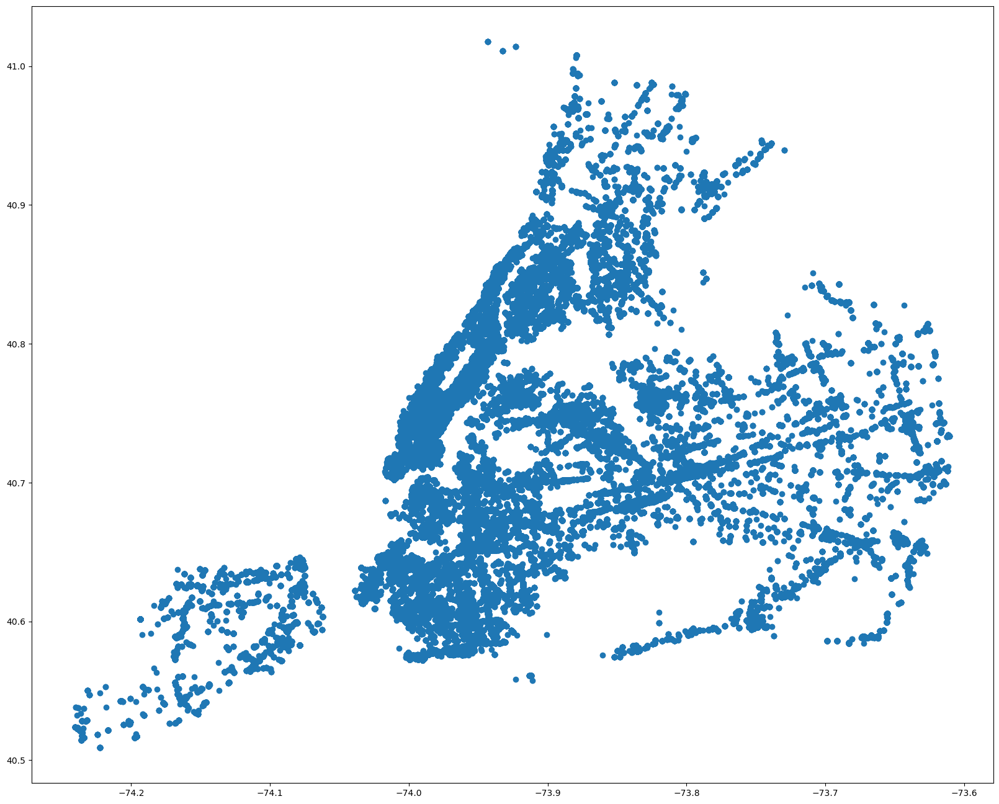

In [36]:
fig, ax = plt.subplots(figsize=(20, 20))
gpd.GeoDataFrame(medicaid_institutions_nyc).geometry.plot(ax=ax)